<a href="https://colab.research.google.com/github/chang-ho-jeon/text_data_analysis/blob/main/naver_movie_sentimental_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 데이터 불러오기
- 데이터 출처: https://github.com/e9t/nsmc/
- `label` : positve(1), negative(0)

In [ ]:
import pandas as pd

# 데이터가 저장되어있는 repository에서 곧장 불러옴, 구분자(tab)
df = pd.read_csv('https://raw.githubusercontent.com/e9t/nsmc/refs/heads/master/ratings_train.txt', sep = '\t')
df.head()

,id,document,label
0,9976970,아 더빙.. 진짜 짜증나네요 목소리,0
1,3819312,흠...포스터보고 초딩영화줄....오버연기조차 가볍지 않구나,1
2,10265843,너무재밓었다그래서보는것을추천한다,0
3,9045019,교도소 이야기구먼 ..솔직히 재미는 없다..평점 조정,0
4,6483659,사이몬페그의 익살스런 연기가 돋보였던 영화!스파이더맨에서 늙어보이기만 했던 커스틴 ...,1


# EDA

In [ ]:
# shape
df.shape

(150000, 3)

shape을 확인한 결과, train 데이터는 150,000개의 인스턴스와 3개의 컬럼으로 구성된 것을 알 수 있음

In [ ]:
# null
df.isnull().sum()

,0
id,0
document,5
label,0


불러온 데이터에 결측치가 포함되어있는지 여부를 확인한 결과, `documnet` 컬럼에 5개의 결측치가 포함되어있음을 확인할 수 있음.

In [ ]:
# document 컬럼에 null이 포함되어있는 경우만 추출
df[df['document'].isnull()]

,id,document,label
25857,2172111,NaN,1
55737,6369843,NaN,1
110014,1034280,NaN,0
126782,5942978,NaN,0
140721,1034283,NaN,0


결측치가 포함된 컬럼의 `label`은 1(positive)가 2개, 0(negative)가 3개로 각 카테고리에 거의 비슷한 분포로 결측치가 포함되어 있음

In [ ]:
df.dropna(inplace = True)

전체 데이터 양에 비해 결측치가 차지하는 비중이 낮으므로, 결측치를 삭제하고 데이터 분석을 진행하고자함

In [ ]:
df.shape

(149995, 3)

결측치 처리 결과 149,995개의 인스턴스가 최종적으로 남아있음을 확인할 수 있음

In [ ]:
# label 분포
df['label'].value_counts()

,count
label,
0,75170
1,74825


train 데이터 셋에 대해서 label의 분포를 확인한 결과, 0(negative)는 75,170개, 1(positive)는 74,825개로 거의 비슷한 비율로 분포되어있음

,len
0,19
1,33
2,17
3,29
4,61
...,...
149995,19
149996,13
149997,31
149998,27


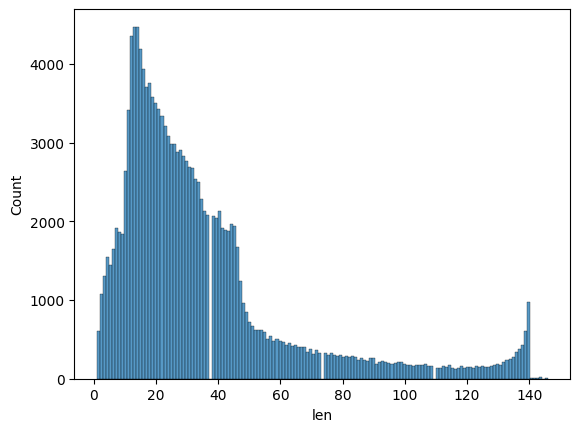

In [ ]:
import seaborn as sns
# 텍스트 길이
df['len'] = df['document'].str.len()
sns.histplot(df['len'])
df['len']

일반적으로 사용자는 20~30글자 사이의 댓글을 가장 많이 다는 것을 알 수 있었다. 추후 신경망을 사용하여 학습하기 위해, 글자수를 특정 값 기준으로 잘라주어야할 경우, 60 글자 정도 수준에서 분할을 하여 처리를 할 예정이다.

## 워드 클라우드

In [ ]:
# 워드 클라우드
import matplotlib.pyplot as plt
from wordcloud import WordCloud

!apt-get install -y fonts-nanum
import matplotlib.font_manager as fm

# 나눔고딕 폰트를 사용하도록 폰트 경로 지정
font_path = "/usr/share/fonts/truetype/nanum/NanumGothic.ttf"
fm.fontManager.addfont(font_path)
plt.rc('font', family='NanumGothic')

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  fonts-nanum
0 upgraded, 1 newly installed, 0 to remove and 49 not upgraded.
Need to get 10.3 MB of archives.
After this operation, 34.1 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 fonts-nanum all 20200506-1 [10.3 MB]
Fetched 10.3 MB in 2s (5,671 kB/s)
Selecting previously unselected package fonts-nanum.
(Reading database ... 123621 files and directories currently installed.)
Preparing to unpack .../fonts-nanum_20200506-1_all.deb ...
Unpacking fonts-nanum (20200506-1) ...
Setting up fonts-nanum (20200506-1) ...
Processing triggers for fontconfig (2.13.1-4.2ubuntu5) ...


### 단계1: 문자열 데이터 추출

- 긍정과 부정 키워드에 대해 각각 워드클라우드를 생성하고자 함
- `document`컬럼에 담긴 데이터를 긍정과 부정으로 나누어서 별도의 변수(`positive_text`, `negative_text`)에 할당

In [ ]:
# negative
negative_text = df[df['label'] == 0]['document']
# positive
positive_text = df[df['label'] == 1]['document']

In [ ]:
print(negative_text)

0                                       아 더빙.. 진짜 짜증나네요 목소리
2                                         너무재밓었다그래서보는것을추천한다
3                             교도소 이야기구먼 ..솔직히 재미는 없다..평점 조정
5             막 걸음마 뗀 3세부터 초등학교 1학년생인 8살용영화.ㅋㅋㅋ...별반개도 아까움.
6                                     원작의 긴장감을 제대로 살려내지못했다.
                                ...                        
149990                                         이걸 영화라고 찎었냐?
149992    공포나 재난영화가 아니라 아예 대놓고 비급 크리쳐개그물임ㅋㅋ 음악 완전 흥겹다ㅋ 5...
149995                                  인간이 문제지.. 소는 뭔죄인가..
149997                      이게 뭐요? 한국인은 거들먹거리고 필리핀 혼혈은 착하다?
149999                             한국 영화 최초로 수간하는 내용이 담긴 영화
Name: document, Length: 75170, dtype: object


In [ ]:
# Dataframe 구조의 문자를 문자열 형태로 변환
negative_text = ' '.join(negative_text.astype(str))
positive_text = ' '.join(positive_text.astype(str))

In [ ]:
print(negative_text)

아 더빙.. 진짜 짜증나네요 목소리 너무재밓었다그래서보는것을추천한다 교도소 이야기구먼 ..솔직히 재미는 없다..평점 조정 막 걸음마 뗀 3세부터 초등학교 1학년생인 8살용영화.ㅋㅋㅋ...별반개도 아까움. 원작의 긴장감을 제대로 살려내지못했다. 별 반개도 아깝다 욕나온다 이응경 길용우 연기생활이몇년인지..정말 발로해도 그것보단 낫겟다 납치.감금만반복반복..이드라마는 가족도없다 연기못하는사람만모엿네 울면서 손들고 횡단보도 건널때 뛰쳐나올뻔 이범수 연기 드럽게못해 취향은 존중한다지만 진짜 내생에 극장에서 본 영화중 가장 노잼 노감동임 스토리도 어거지고 감동도 어거지 굿바이 레닌 표절인것은 이해하는데 왜 뒤로 갈수록 재미없어지냐 재미없다 지루하고. 같은 음식 영화인데도 바베트의 만찬하고 넘 차이남....바베트의 만찬은 이야기도 있고 음식 보는재미도 있는데 ; 이건 볼게없다 음식도 별로 안나오고, 핀란드 풍경이라도 구경할랫는데 그것도 별로 안나옴 ㅡㅡ 주제는 좋은데 중반부터 지루하다 다 짤랐을꺼야. 그래서 납득할 수 없었던거야.. 그럴꺼야.. 꼭 그랬던걸꺼야.. 카밀라벨 발연기 졸쓰레기 진부하고말도안됌ㅋㅋ 아..시간아까워 1%라도 기대했던 내가 죄인입니다 죄인입니다.... 키이라 나이틀리가 연기하고자 했던건 대체 정신장애일까 틱장애일까 포스터는 있어보이는데 관객은 114명이네 '다 알바생인가 내용도 없고 무서운거도 없고 웃긴거도 하나도 없음 완전 별싱거운 영화.ㅇ.ㅇ내ㅇ시간 넘 아까움 .. . 완전 낚임 평점에속지마시길시간낭비 돈낭비임 리얼리티가 뛰어나긴 한데 큰 공감은 안간다. 이민기캐릭터는 정신의학상 분노조절장애 초기 증상일거다. 툭하면 사람패고 욕하고 물건 파손하고.. 조금 오바였음. 극 초반엔 신선했는데 가면 갈수록 이민기 정신상태 공감불가. 마이너스는 왜없냐 ㅋ 뮤비 보고 영화수준 딱 알만하더군 ㅉㅉ 북한에서 이런거 만들라고 돈 대주던? 난 우리영화를 사랑합니다....^^; 야 세르게이! 작은고추의 매운맛을 보여주마! 포퐁저그 콩진호가 간다 난또 저 꼬마애가 

### 단계2: 명사 추출(토큰화)

In [ ]:
!pip install konlpy

주어진 문장에서 명사만 추출하여 토큰화하고, 명사의 빈도수에 기초하여 워드클라우드를 생성하고자 함

In [ ]:
from konlpy.tag import Okt
okt = Okt()

# 각 문자열에서 명사만 추출
negative_nouns = okt.nouns(negative_text)
positive_nouns = okt.nouns(positive_text)

In [ ]:
total_nouns = okt.nouns(negative_text + positive_text)

In [ ]:
print(total_nouns)

['더빙', '진짜', '목소리', '무재', '밓었', '다그', '래서', '추천', '교도소', '이야기', '구먼', '재미', '평점', '조정', '막', '걸음', '마', '세', '초등학교', '학년', '생인', '영화', '반개', '움', '원작', '긴장감', '제대로', '별', '반개', '욕', '이응경', '길용우', '생활', '년', '정말', '발', '해도', '그것', '납치', '감금', '반복', '반복', '드라마', '가족', '연기', '사람', '네', '울면', '손', '횡단보도', '때', '뻔', '이범수', '연기', '취향', '존중', '다지', '진짜', '내생', '극장', '영화', '가장', '노잼', '노', '감동', '임', '스토리', '어거지', '감동', '어거지', '굿바이', '레닌', '표절', '것', '이해', '왜', '뒤', '갈수록', '재미', '음식', '영화', '도', '바베트', '만찬', '바베트', '만찬', '이야기', '음식', '재미', '이건', '볼', '음식', '별로', '핀란드', '풍경', '할랫', '그것', '별로', '주제', '중반', '짤랐을꺼', '납득', '수', '꼭', '카밀라', '벨', '발연기', '졸', '쓰레기', '도안', '시간', '내', '죄인', '죄인', '키이라', '나이틀리', '연기', '대체', '정신장애', '틱장애', '포스터', '관객', '명', '알바생', '내용', '하나', '완전', '별', '영화', '내', '시간', '움', '완전', '낚임', '평점', '속지', '시간', '낭비', '돈', '낭비', '임', '리얼리티', '공감', '안', '간다', '이민기', '캐릭터', '정신의학', '분노조절', '장애', '초기', '증상', '툭하면', '사람', '패', '욕', '물건', '파손', '조금', '바', '초반', '가면', '갈수록', '이민기', '정신

In [ ]:
print(negative_nouns)

['더빙', '진짜', '목소리', '무재', '밓었', '다그', '래서', '추천', '교도소', '이야기', '구먼', '재미', '평점', '조정', '막', '걸음', '마', '세', '초등학교', '학년', '생인', '영화', '반개', '움', '원작', '긴장감', '제대로', '별', '반개', '욕', '이응경', '길용우', '생활', '년', '정말', '발', '해도', '그것', '납치', '감금', '반복', '반복', '드라마', '가족', '연기', '사람', '네', '울면', '손', '횡단보도', '때', '뻔', '이범수', '연기', '취향', '존중', '다지', '진짜', '내생', '극장', '영화', '가장', '노잼', '노', '감동', '임', '스토리', '어거지', '감동', '어거지', '굿바이', '레닌', '표절', '것', '이해', '왜', '뒤', '갈수록', '재미', '음식', '영화', '도', '바베트', '만찬', '바베트', '만찬', '이야기', '음식', '재미', '이건', '볼', '음식', '별로', '핀란드', '풍경', '할랫', '그것', '별로', '주제', '중반', '짤랐을꺼', '납득', '수', '꼭', '카밀라', '벨', '발연기', '졸', '쓰레기', '도안', '시간', '내', '죄인', '죄인', '키이라', '나이틀리', '연기', '대체', '정신장애', '틱장애', '포스터', '관객', '명', '알바생', '내용', '하나', '완전', '별', '영화', '내', '시간', '움', '완전', '낚임', '평점', '속지', '시간', '낭비', '돈', '낭비', '임', '리얼리티', '공감', '안', '간다', '이민기', '캐릭터', '정신의학', '분노조절', '장애', '초기', '증상', '툭하면', '사람', '패', '욕', '물건', '파손', '조금', '바', '초반', '가면', '갈수록', '이민기', '정신

### 단계3: 각 명사 별 빈도수 확인
- Counter 사용
  -  특정 단어가 몇 번 등장했는지 딕셔너리 타입으로 반환(예: {"영화", 50})

In [ ]:
# 추출한 명사에서 각 명사가 몇 번 등장했는지 확인
from collections import Counter # 특정 단어가 몇번 등장했는지 딕셔너리 타입으로 반환(예: {"key", 50})
negative_counts = Counter(negative_nouns)
positive_counts = Counter(positive_nouns)

In [ ]:
total_nouns = Counter(total_nouns)

In [ ]:
print(negative_counts)

Counter({'영화': 24598, '점': 4573, '진짜': 4333, '이': 4132, '평점': 3639, '스토리': 3481, '왜': 3356, '쓰레기': 3346, '정말': 3259, '것': 3160, '뭐': 3130, '감독': 2826, '그냥': 2823, '연기': 2753, '내용': 2720, '시간': 2509, '거': 2443, '재미': 2407, '사람': 2404, '좀': 2404, '말': 2374, '배우': 2248, '최악': 2238, '내': 2161, '이건': 2141, '더': 2057, '드라마': 2039, '생각': 1982, '돈': 1955, '보고': 1895, '별로': 1892, '걸': 1610, '하나': 1584, '개': 1507, '그': 1505, '때': 1497, '주인공': 1445, '나': 1421, '정도': 1399, '처음': 1342, '끝': 1316, '연출': 1270, '볼': 1261, '액션': 1256, '임': 1244, '수준': 1200, '완전': 1147, '이해': 1137, '작품': 1135, '느낌': 1120, '여자': 1085, '듯': 1083, '장면': 1083, '안': 1080, '수': 1059, '때문': 1049, '무슨': 1027, '감동': 1020, '전개': 1008, '못': 998, '애': 989, '소재': 981, '이야기': 959, '결말': 925, '보기': 918, '편': 889, '마지막': 874, '원작': 834, '실망': 833, '이영화': 813, '노잼': 763, '전혀': 762, '게': 757, '점도': 757, '별': 743, '알바': 714, '급': 704, '차라리': 703, '줄': 700, '남자': 686, '작가': 685, '움': 684, '중': 684, '반전': 666, '뿐': 656, '코미디': 655, '보지': 65

### 단계4: Top 50 단어 추출

In [ ]:
# 자주 등장한(예. 50번 이상 등장한) 단어에 대해서만 워드 클라우드 생성
top_50_negative = negative_counts.most_common(50) # 특정 빈도수 이상 나타난 단어들을 반환
top_50_positive = positive_counts.most_common(50)

In [ ]:
print(top_50_negative)

[('영화', 24598), ('점', 4573), ('진짜', 4333), ('이', 4132), ('평점', 3639), ('스토리', 3481), ('왜', 3356), ('쓰레기', 3346), ('정말', 3259), ('것', 3160), ('뭐', 3130), ('감독', 2826), ('그냥', 2823), ('연기', 2753), ('내용', 2720), ('시간', 2509), ('거', 2443), ('재미', 2407), ('사람', 2404), ('좀', 2404), ('말', 2374), ('배우', 2248), ('최악', 2238), ('내', 2161), ('이건', 2141), ('더', 2057), ('드라마', 2039), ('생각', 1982), ('돈', 1955), ('보고', 1895), ('별로', 1892), ('걸', 1610), ('하나', 1584), ('개', 1507), ('그', 1505), ('때', 1497), ('주인공', 1445), ('나', 1421), ('정도', 1399), ('처음', 1342), ('끝', 1316), ('연출', 1270), ('볼', 1261), ('액션', 1256), ('임', 1244), ('수준', 1200), ('완전', 1147), ('이해', 1137), ('작품', 1135), ('느낌', 1120)]


### 단계5: 워드 클라우드 생성
(참고)
top 50 단어에 대해서만 워드클라우드를 생성하였지만, 불용어처리(예. 자주 등장하는 단어 중 긍/부정의 의미가 없는 '영화','정말', '진짜' 등)를 하고, 단어수를 늘려서 워드클라우드를 생성한다면 좀 더 긍/부정 댓글에 자주 사용된 단어들을 확인할 수 있음

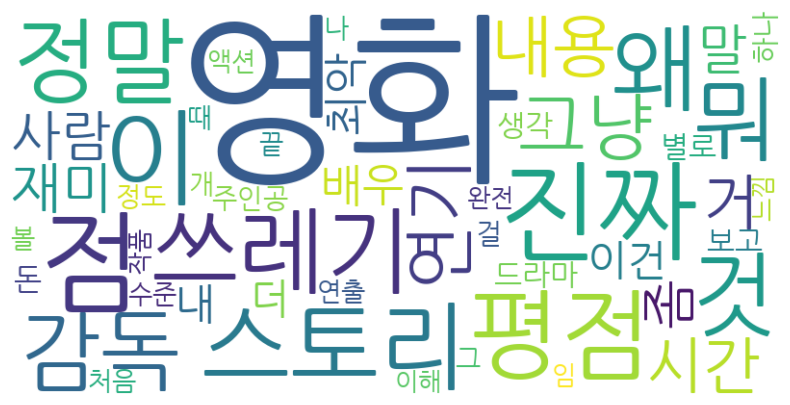

In [ ]:
wordcloud = WordCloud(font_path=font_path,
                      width=800,
                      height=400,
                      background_color='white').generate_from_frequencies(dict(top_50_negative)) # 빈도수에 따라 워드 클라우드 생성

# 결과 시각화
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

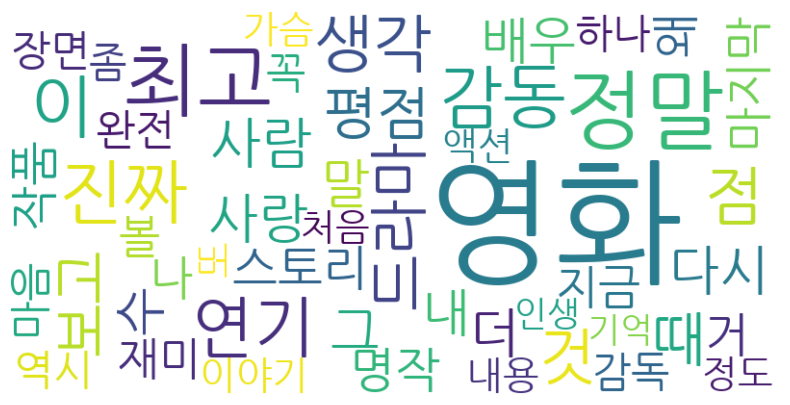

In [ ]:
wordcloud = WordCloud(font_path=font_path,
                      width=800,
                      height=400,
                      background_color='white').generate_from_frequencies(dict(top_50_positive)) # 빈도수에 따라 워드 클라우드 생성

# 결과 시각화
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

(참고)

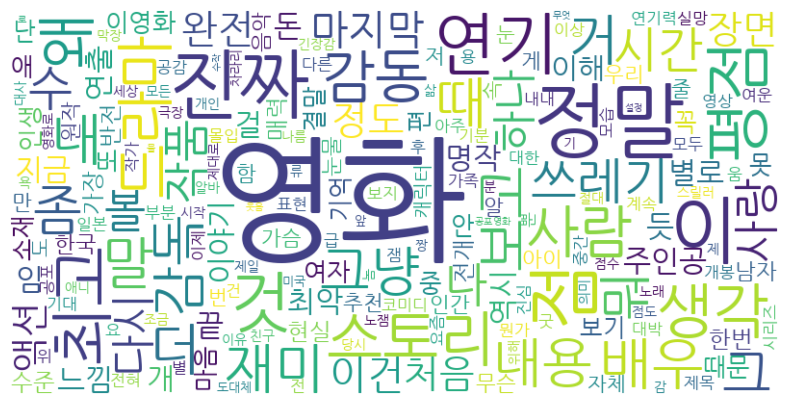

In [ ]:
wordcloud = WordCloud(font_path=font_path,
                      width=800,
                      height=400,
                      background_color='white').generate_from_frequencies(dict(total_nouns)) # 빈도수에 따라 워드 클라우드 생성

# 결과 시각화
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [ ]:
dir(WordCloud)

['__array__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_check_generated',
 '_draw_contour',
 '_get_bolean_mask',
 'fit_words',
 'generate',
 'generate_from_frequencies',
 'generate_from_text',
 'process_text',
 'recolor',
 'to_array',
 'to_file',
 'to_image',
 'to_svg']

# 데이터 전처리
- 텍스트 데이터를 신경망에 입력하기 위한 전처리

## 단계1. 토큰화

In [ ]:
from konlpy.tag import Okt
okt = Okt()

In [ ]:
def tokenize(doc):
  """Tokenizes a Korean document using Okt.

  Args:
    doc: The input document string.

  Returns:
    A list of tokens.
  """
  # Convert the input to string before processing
  return okt.nouns(str(doc))

df['tokens'] = df['document'].apply(tokenize)

In [ ]:
# df['tokens'] = df['document'].apply(lambda x: okt.nouns(str(x)))

## 단계2. (옵션) 불용어 제거

In [ ]:
stopwrods = ['의','가','이','은','아','너무','들','는','좀','잘','걍','과','도','를','으로','자','에','와','한','하다']

In [ ]:
# def tokenize(doc):
#   tokens = okt.nouns(str(doc))
#   # 불용어 제거
#   tokens = [token for token in tokens if token not in stopwrods]
#   return tokens

# df['tokens'] = df['document'].apply(tokenize)

## 단계3. (옵션) 특정 빈도수 이상 등장한 토큰만 남기기

In [ ]:
from tensorflow.keras.preprocessing.text import Tokenizer

# 토크나이저로 단어 집합을 생성하고, 빈도수 기준 상위 20,000개의 단어만 사용
tokenizer = Tokenizer(num_words = 20000)
tokenizer.fit_on_texts(df['tokens'])

In [ ]:
df.head()

,id,document,label,len,tokens
0,9976970,아 더빙.. 진짜 짜증나네요 목소리,0,19,"[더빙, 진짜, 목소리]"
1,3819312,흠...포스터보고 초딩영화줄....오버연기조차 가볍지 않구나,1,33,"[흠, 포스터, 보고, 초딩, 영화, 줄, 오버, 연기]"
2,10265843,너무재밓었다그래서보는것을추천한다,0,17,"[무재, 밓었, 다그, 래서, 추천]"
3,9045019,교도소 이야기구먼 ..솔직히 재미는 없다..평점 조정,0,29,"[교도소, 이야기, 구먼, 재미, 평점, 조정]"
4,6483659,사이몬페그의 익살스런 연기가 돋보였던 영화!스파이더맨에서 늙어보이기만 했던 커스틴 ...,1,61,"[몬페, 의, 연기, 영화, 스파이더맨, 커스틴, 던스트]"


## 단계4. 토큰을 벡터(숫자)로 변환

In [ ]:
# df['tokens']의 값을 벡터(숫자)로 변환
sequences = tokenizer.texts_to_sequences(df['tokens'])
sequences[:5]

[[237, 3, 360],
 [538, 238, 16, 336, 1, 94, 869, 6],
 [1605, 3616, 4648, 98],
 [4827, 51, 6218, 24, 7, 2491],
 [16273, 201, 6, 1, 1710, 11603, 16274]]

## 단계5. 글자 수 맞추기(pad_sequence)

In [ ]:
from tensorflow.keras.utils import pad_sequences
# 패딩을 사용하여 시퀀스 길이를 60으로 맞춤
X = pad_sequences(sequences, maxlen = 60)

## 단계6. 학습/테스트 데이터 셋 분할

In [ ]:
y = df['label'].values

In [ ]:
# 데이터 분할
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42, stratify = y)

# 학습 모델 생성
 - LSTM 신경망을 사용하여 긍부정(이진분류)을 판단할 수 있는 분류기 생성

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, Bidirectional, LSTM, Dense

model = Sequential()
# 입력 데이터(20000개)를 128 차원 벡터로 임베딩(차원축소)
model.add(Embedding(20000, 128))
# 양방향 LSTM
model.add(Bidirectional(LSTM(256, return_sequences=True)))
model.add(Bidirectional(LSTM(128)))
# 분류기
model.add(Dense(1, activation = 'sigmoid'))

model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

In [ ]:
import os
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# 학습 결과를 저장하기 위한 환경 설정
MODEL_DIR = './model/'
if not os.path.exists(MODEL_DIR): # ./model/ 이라는 폴더가 존재하지 않으면
    os.mkdir(MODEL_DIR)           # ./model/ 이라는 폴더를 생성(mkdir())
modelpath="./model/{epoch:02d}-{val_loss:.2f}.keras"

# 학습 중 모니터링 할 조건 설정
checkpointer = ModelCheckpoint(filepath=modelpath,
                               monitor='val_loss',
                               verbose=1,
                               save_best_only=True)

# 학습의 이른 종료를 위한 조건 설정
early_stopping_callback = EarlyStopping(monitor='val_loss', patience=5)

In [ ]:
history = model.fit(X_train, y_train, batch_size=256, epochs=50,
                    validation_split=0.2,
                    callbacks=[early_stopping_callback, checkpointer])

Epoch 1/50
375/375 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - accuracy: 0.6984 - loss: 0.5506
Epoch 1: val_loss improved from inf to 0.49135, saving model to ./model/01-0.49.keras
375/375 ━━━━━━━━━━━━━━━━━━━━ 36s 70ms/step - accuracy: 0.6985 - loss: 0.5504 - val_accuracy: 0.7496 - val_loss: 0.4913
Epoch 2/50
375/375 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - accuracy: 0.7949 - loss: 0.4267
Epoch 2: val_loss improved from 0.49135 to 0.47100, saving model to ./model/02-0.47.keras
375/375 ━━━━━━━━━━━━━━━━━━━━ 26s 69ms/step - accuracy: 0.7949 - loss: 0.4267 - val_accuracy: 0.7685 - val_loss: 0.4710
Epoch 3/50
375/375 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - accuracy: 0.8232 - loss: 0.3782
Epoch 3: val_loss did not improve from 0.47100
375/375 ━━━━━━━━━━━━━━━━━━━━ 42s 70ms/step - accuracy: 0.8232 - loss: 0.3782 - val_accuracy: 0.7669 - val_loss: 0.4898
Epoch 4/50
375/375 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - accuracy: 0.8425 - loss: 0.3351
Epoch 4: val_loss did not improve from 0.47100
375/375 ━━━━━━━━━━━━━━━━━

# 평가
- 정확도(accuracy) 기반 평가

In [ ]:
model.evaluate(X_test, y_test)

938/938 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/step - accuracy: 0.7539 - loss: 0.7483


[0.7558347582817078, 0.7513250708580017]

# 예측
- "이 영화 정말 재미있어요!"
- "돈 내고 보기 아까움..."

-------------------------------

1. 토큰화: okt.nouns()
2. 토큰을 벡터로 변환: tokenizer<br>
  ⚠주의⚠
  - tokenizer 객체를 새로 생성하지 않는다!
  - tokenizer에서 fit 작업을 새로하지 않는다!
  - 즉, 이전에 생성한 tokenizer를 재활용해야만 한다!

 3. 글자 수 맞추기: pad_sequences

In [ ]:
sentence = "돈 내고 보기 아까움..."

# 토큰화
tonized_sentece = okt.nouns(sentence)

# 토큰을 벡터로 변환
X = tokenizer.texts_to_sequences([tonized_sentece])

# 글자 수 맞추기
padded_X = pad_sequences(X, maxlen = 60)

In [ ]:
if model.predict(padded_X) >= 0.5:
  print('긍정')
else:
  print('부정')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
부정
